# This is a Python Project File to work on Leading Club Studies

### Project Members:

__1. Prashant Mohan Sinha__

__2. Vijay Prasad__

<hr>

## Project Business Understanding:

You work for a consumer finance company which specialises in lending various types of loans to urban customers. When the company receives a loan application, the company has to make a decision for loan approval based on the applicant’s profile. Two types of risks are associated with the bank’s decision:

> #### If the applicant is likely to repay the loan, then not approving the loan results in a loss of business to the company.
>
> #### If the applicant is not likely to repay the loan, i.e. he/she is likely to default, then approving the loan may lead to a financial loss for the company.

 

The data given below contains the information about past loan applicants and whether they ‘defaulted’ or not. The aim is to identify patterns which indicate if a person is likely to default, which may be used for taking actions such as denying the loan, reducing the amount of loan, lending (to risky applicants) at a higher interest rate, etc.

 

In this case study, you will use EDA to understand how consumer attributes and loan attributes influence the tendency of default.

<hr>

## Project Objectives
Like most other lending companies, lending loans to ‘risky’ applicants is the largest source of financial loss (called credit loss). The credit loss is the amount of money lost by the lender when the borrower refuses to pay or runs away with the money owed. In other words, borrowers who default cause the largest amount of loss to the lenders.

Objective is to identify the risky loan applicants at the time of loan application so that such loans can be reduced thereby cutting down the amount of credit loss. Identification of such applicants using EDA is the aim of this case study.

In other words, to understand the driving factors (or driver variables) behind loan default, i.e. the variables which are strong indicators of default. The company can utilise this knowledge for its portfolio and risk assessment. And thus minimise the risk of losing money while lending to customers.

<hr>

## Exploratory Data Analysis
### Data
We have been provided with the Private Data of Lending Club.
The complete loan data for all loans issued through the time period 2007 to 2011.

We also have a data dictionary which describes the meaning of these variables.

<hr>

### Let's begin the code to proceed with 
####         1. Data Understanding, 
####         2. Data Cleaning & Formatting
####         3. Data Analysis 

<hr>

In [1]:
# Import the Requisite Libraries
%matplotlib inline
import numpy as np, pandas as pd, matplotlib.pyplot as plt
import plotly.express as px
import seaborn as sns
import datetime

<hr>

## Read CSV Data file & Display some Info 

In [2]:
# Read the csv file
raw_data=pd.read_csv('loan/loan.csv',low_memory=False)

# Display the Random 6 Rows 
raw_data.sample(6)                    

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,num_tl_90g_dpd_24m,num_tl_op_past_12m,pct_tl_nvr_dlq,percent_bc_gt_75,pub_rec_bankruptcies,tax_liens,tot_hi_cred_lim,total_bal_ex_mort,total_bc_limit,total_il_high_credit_limit
1002,1057776,1289141,16000,16000,16000.0,36 months,12.69%,536.72,B,B5,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
34878,444950,543058,6000,6000,6000.0,36 months,7.74%,187.32,A,A3,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
1956,1043163,1273265,4500,4500,4500.0,36 months,11.71%,148.85,B,B3,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
15929,740432,938138,16600,16600,16600.0,60 months,12.99%,377.62,C,C1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
19748,665465,850805,16000,16000,16000.0,60 months,17.14%,398.85,E,E3,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN
16972,722310,917125,4500,4500,4500.0,36 months,14.54%,154.99,D,D1,...,NaN,NaN,NaN,NaN,0.0,0.0,NaN,NaN,NaN,NaN


In [3]:
# Display the Info of the Raw Data
raw_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Columns: 111 entries, id to total_il_high_credit_limit
dtypes: float64(74), int64(13), object(24)
memory usage: 33.6+ MB


<hr>

#### Observation:

There are total 39717 entries in the given file (_'loan.csv'_) and 111 attributes for each id. The summary of data type of the attribute are as follows:
  
 * Numerical variables: 74 columns of float64 type and 13 columns of int64 type 
 * Categorical Varibale: 24 columns

The above summary is based on just after merely loading the given file. It may likely that some of columns have partial data or complete lack of any data. Let's move ahead to look into the number of Non-NULL value entries in the given columns. 
 
Most probably due to large number of columns, raw_data.info() does not able to list out all the columns names. Let's further dive into & understand the provided csv data set.

 <hr>

## Stage1: Data Understanding 

 #### 1.1 Check the Total number of Non-NULL Values in each columns & plot it

In [4]:
# Check the total Nan Values in each columns & calculate the percentage of it
# Higher the NaN/NA value in the column, lower the percentage value
# e.g. any having column having no NULL value then Nan_column_sum will be 0%.

Nan_column_sum=100-(raw_data.isna().sum() / raw_data.index.size *100)

# Create a New DataFram 
NonNULL_DF = pd.DataFrame(data = Nan_column_sum);
NonNULL_DF.reset_index(inplace=True)
NonNULL_DF.columns = ['attr','Non_NULL_Values']

# Display the arbitrary 5 rows
NonNULL_DF.sample(5)

,attr,Non_NULL_Values
80,mo_sin_old_il_acct,0.000000
48,last_credit_pull_d,99.994964
93,num_bc_tl,0.000000
11,emp_length,97.293350
13,annual_inc,100.000000


In [5]:
# Scatter Plot of Non-NULL of Each Column (Columns names from left to Right is represented by 0 110)

fig = px.scatter(data_frame=NonNULL_DF, x=NonNULL_DF.index, y=NonNULL_DF.Non_NULL_Values, \
                 hover_name=NonNULL_DF.attr, \
                 title="Scatter Plot of Non-NULL Data Column")

fig.show()

In [6]:
# Display the counts of Non-NULL for the above mentioned classes
print("\nTotal Counts of Columns with no NULL Values or very few NULL values = ", \
      len(NonNULL_DF.attr[NonNULL_DF.Non_NULL_Values>=60]))
print("\nTotal Counts of Columns with no NULL Values less than 40% of total entries = ", \
      len(NonNULL_DF.attr[NonNULL_DF.Non_NULL_Values<=60]))


Total Counts of Columns with no NULL Values or very few NULL values =  54

Total Counts of Columns with no NULL Values less than 40% of total entries =  57


<hr>

#### Observation:

* There is one column name 'desc' (data type object), which is approx. 67.42% of total entries. For the sake of keeping the information provided in description, we will fill it with 'Not_Mentioned'.

* With the above observation, we can divide the data columns in two parts:
    1. Accepted columns >= 60%  
    2. Rejected Columns <60 % 

* We can now filter the Dataframe with accepted columns. 

* Data understanding will continue as we forward with data cleaning & formatting.


>Data Dictionary: desc: Loan description provided by the borrower

<hr>

## Stage2: Data Cleaning & Formatting with continuation of Data Understanding

__2.1 Drop the No Use Columns (having NULL Values in all entries ) from DataFrame & display first five rows__

In [7]:
clean_data=raw_data.drop(columns=list(NonNULL_DF.attr[NonNULL_DF.Non_NULL_Values<60]))
clean_data.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,last_pymnt_amnt,last_credit_pull_d,collections_12_mths_ex_med,policy_code,application_type,acc_now_delinq,chargeoff_within_12_mths,delinq_amnt,pub_rec_bankruptcies,tax_liens
0,1077501,1296599,5000,5000,4975.0,36 months,10.65%,162.87,B,B2,...,171.62,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
1,1077430,1314167,2500,2500,2500.0,60 months,15.27%,59.83,C,C4,...,119.66,Sep-13,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
2,1077175,1313524,2400,2400,2400.0,36 months,15.96%,84.33,C,C5,...,649.91,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
3,1076863,1277178,10000,10000,10000.0,36 months,13.49%,339.31,C,C1,...,357.48,Apr-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0
4,1075358,1311748,3000,3000,3000.0,60 months,12.69%,67.79,B,B5,...,67.79,May-16,0.0,1,INDIVIDUAL,0,0.0,0,0.0,0.0


As stated above fill the 'desc' with 'Not_Mentioned' where it is 'NA'

In [8]:
clean_data['desc']=clean_data['desc'].fillna('Not_Mentioned')

__2.2 Find the number of distinct values in each columns & drop the columns having only one unique value__

In [9]:
clean_data.nunique().sort_values()

tax_liens                         1
delinq_amnt                       1
chargeoff_within_12_mths          1
acc_now_delinq                    1
application_type                  1
policy_code                       1
initial_list_status               1
collections_12_mths_ex_med        1
pymnt_plan                        1
term                              2
pub_rec_bankruptcies              3
verification_status               3
loan_status                       3
pub_rec                           5
home_ownership                    5
grade                             7
inq_last_6mths                    9
emp_length                       11
delinq_2yrs                      11
purpose                          14
sub_grade                        35
open_acc                         40
addr_state                       50
issue_d                          55
total_acc                        82
last_pymnt_d                    101
last_credit_pull_d              106
int_rate                    

>Details of above listed variable can be accessed from the provided 'Data_Dictionary.xlsx'

<hr>

Drop the columns with only one unique value

In [10]:
clean_data=clean_data.loc[:,raw_data.apply(pd.Series.nunique) != 1]

Now Lets check the DataFrame Matrix Size (Rows, Columns)

In [11]:
print('DataFrame Matrix Size (Rows, Columns) after dropping some of columns: ', clean_data.shape)

DataFrame Matrix Size (Rows, Columns) after dropping some of columns:  (39717, 45)


Number of columns is decreased by 66. Now we can display the info of the DataFrame.

In [12]:
# Display the Info of the Raw Data
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 39717 entries, 0 to 39716
Data columns (total 45 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       39717 non-null  int64  
 1   member_id                39717 non-null  int64  
 2   loan_amnt                39717 non-null  int64  
 3   funded_amnt              39717 non-null  int64  
 4   funded_amnt_inv          39717 non-null  float64
 5   term                     39717 non-null  object 
 6   int_rate                 39717 non-null  object 
 7   installment              39717 non-null  float64
 8   grade                    39717 non-null  object 
 9   sub_grade                39717 non-null  object 
 10  emp_title                37258 non-null  object 
 11  emp_length               38642 non-null  object 
 12  home_ownership           39717 non-null  object 
 13  annual_inc               39717 non-null  float64
 14  verification_status   

Let's check the entries of the columns 'loan_status'
>Data Dictionary: loan_status: Current status of the loan

In [13]:
clean_data['loan_status'].value_counts()

Fully Paid     32950
Charged Off     5627
Current         1140
Name: loan_status, dtype: int64

__2.3 Drop the 'Current' loan_status Rows__

The given assignment is to analyze the fully paid and default loan. In such case the record of loan_status="Current" can be dropped.

In [14]:
clean_data=clean_data[clean_data['loan_status']!="Current"]

__2.4 Type conversion of columns: 'term' & 'int_rate'__

  Remove months & % from the column 'term' & 'int_rate' and convert it from object data type to integer & float type respectively.
  
>Data Dictionary: term: The number of payments on the loan. Values are in months and can be either 36 or 60. int_rate: Interest Rate on the loan.
  

In [15]:
clean_data['term']= clean_data['term'].map(lambda x:x.strip().replace(" months","")).astype(float).astype('int32')
clean_data['int_rate']=clean_data['int_rate'].map(lambda x:x.replace("%","")).astype(float)

__2.5 Drop the rows where emp_length is NULL__

From the above plot of Non-NULL Data Column, it is clear that only 2.7% (approx.) of column 'emp_length' is having NULL values, thus corresponding rows can be dropped from the DataFrame.

>Data Dictionary: emp_length: Employment length in years. Possible values are between 0 and 10 where 0 means less than one year and 10 means ten or more years. 


In [16]:
print('Size of Dataframe before dropping NULL Rows of emp_length = ', clean_data.shape)
clean_data=clean_data[~clean_data.emp_length.isna()]
print('Size of Dataframe after dropping NULL Rows of emp_length = ', clean_data.shape)

Size of Dataframe before dropping NULL Rows of emp_length =  (38577, 45)
Size of Dataframe after dropping NULL Rows of emp_length =  (37544, 45)


Let's check the value_counts() of column 'emp_length'

In [17]:
clean_data['emp_length'].value_counts()

10+ years    8488
< 1 year     4508
2 years      4291
3 years      4012
4 years      3342
5 years      3194
1 year       3169
6 years      2168
7 years      1711
8 years      1435
9 years      1226
Name: emp_length, dtype: int64

__2.6 Type conversion of column 'emp_length'__

Let's change the emp_length from categorical value to continuous variable. Less than One year to be assigned as 0, while 10+ is to be assigned as 10.

In [18]:
clean_data['emp_length'] = clean_data['emp_length'].map(lambda x: x.rstrip('years'))
clean_data['emp_length'] = clean_data['emp_length'].map(lambda x: '0' if x.strip() == "< 1" else x)
clean_data['emp_length'] = clean_data['emp_length'].map(lambda x: x.rstrip('+ '))
clean_data['emp_length'] = clean_data['emp_length'].astype('int32')

Let's re-check the value_counts() of column 'emp_length' after assigning them as continous variable.

In [19]:
print('value_counts() of emp_length:\n ', clean_data['emp_length'].value_counts())
print('\ndata type of emp_length: ', clean_data['emp_length'].dtype)

value_counts() of emp_length:
  10    8488
0     4508
2     4291
3     4012
4     3342
5     3194
1     3169
6     2168
7     1711
8     1435
9     1226
Name: emp_length, dtype: int64

data type of emp_length:  int32


__2.7 Glance at the 'annual_inc'__

>Data Dictionary: annual_inc: The self-reported annual income provided by the borrower during registration. 

In [20]:
clean_data['annual_inc'].describe()

count    3.754400e+04
mean     6.940708e+04
std      6.467698e+04
min      4.000000e+03
25%      4.100000e+04
50%      6.000000e+04
75%      8.300000e+04
max      6.000000e+06
Name: annual_inc, dtype: float64

Variation in Annual income from thousand to Million. Let's convert the annual income into 1000 units and rename the column name.

In [21]:
clean_data['annual_inc']=clean_data['annual_inc']/1000
clean_data.rename(columns={'annual_inc':'annual_inc_in_thousand'}, inplace=True)
clean_data['annual_inc_in_thousand'].describe()

count    37544.000000
mean        69.407080
std         64.676984
min          4.000000
25%         41.000000
50%         60.000000
75%         83.000000
max       6000.000000
Name: annual_inc_in_thousand, dtype: float64

In [22]:
# Scatter Plot of Non-NULL of Each Column (Columns names from left to Right is represented by 0 110)

fig = px.scatter(data_frame=clean_data, x=clean_data.index, y=clean_data.annual_inc_in_thousand, \
                 hover_name=clean_data.verification_status, hover_data=["desc", "purpose", "dti"], \
                 title="Scatter Plot of Annual Income (in thousand)", color='loan_status')

fig.show()

In [23]:
print('Size of DataFrame before rows removal: ', clean_data.shape[0])

Size of DataFrame before rows removal:  37544


In [24]:
clean_data=clean_data[clean_data['annual_inc_in_thousand'] <1000]

In [25]:
print('Size of DataFrame after rows removal: ', clean_data.shape[0])

Size of DataFrame after rows removal:  37530


<hr>

#### Observation:

* 75 % Quantile of Annual Income is 83000.

* From the above chart, the annual income above 1000k are all have paid the loan ammount except one outlier case of charged off case where the income is 1200k and loan is taken for debt consolidation.

* There is big gap between in general average annual income & high income people. To make data distibution not biased towards high income, rows(14) having annual income 1000K are removed.   

 
<hr>

In [26]:
clean_data.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 37530 entries, 0 to 39716
Data columns (total 45 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   id                       37530 non-null  int64  
 1   member_id                37530 non-null  int64  
 2   loan_amnt                37530 non-null  int64  
 3   funded_amnt              37530 non-null  int64  
 4   funded_amnt_inv          37530 non-null  float64
 5   term                     37530 non-null  int32  
 6   int_rate                 37530 non-null  float64
 7   installment              37530 non-null  float64
 8   grade                    37530 non-null  object 
 9   sub_grade                37530 non-null  object 
 10  emp_title                36122 non-null  object 
 11  emp_length               37530 non-null  int32  
 12  home_ownership           37530 non-null  object 
 13  annual_inc_in_thousand   37530 non-null  float64
 14  verification_status   

1408 & 10 entries of categorical column 'emp_title' & 'title' are missing. Let's fill it with 'Not_Mentioned'.

>Data Dictionary: emp_title : The job title supplied by the Borrower when applying for the loan. title: The loan title provided by the borrower.

In [27]:
clean_data['emp_title']=clean_data['emp_title'].fillna('Not_Mentioned')
clean_data['title']=clean_data['title'].fillna('Not_Mentioned')

We can drop some more columns:

In [28]:
clean_data=clean_data.drop(columns=['last_pymnt_d', 'last_credit_pull_d', 'revol_util','out_prncp', 'out_prncp_inv'])

Let's check the record of the 'pub_rec_bankruptcies'


>Data Dictionary: pub_rec_bankruptcies : Number of public record bankruptcies.

In [29]:
clean_data['pub_rec_bankruptcies'].value_counts()

0.0    35299
1.0     1530
2.0        5
Name: pub_rec_bankruptcies, dtype: int64

Let's fill the missing values with the median value 

In [30]:
clean_data['pub_rec_bankruptcies']=clean_data['pub_rec_bankruptcies'].fillna(clean_data['pub_rec_bankruptcies'].median())
clean_data['pub_rec_bankruptcies'].value_counts()

0.0    35995
1.0     1530
2.0        5
Name: pub_rec_bankruptcies, dtype: int64

Take out the month and year from the issue date of the loan

>Data Dictionary: issue_d: The month which the loan was funded.

In [31]:
clean_data['issue_d'].value_counts()

Dec-11    1994
Nov-11    1971
Oct-11    1863
Sep-11    1836
Aug-11    1751
Jun-11    1675
Jul-11    1673
May-11    1554
Apr-11    1505
Mar-11    1402
Jan-11    1335
Feb-11    1239
Dec-10    1220
Nov-10    1094
Jul-10    1091
Oct-10    1086
Aug-10    1058
Sep-10    1057
Jun-10     994
May-10     893
Apr-10     806
Mar-10     718
Feb-10     605
Nov-09     600
Dec-09     597
Jan-10     585
Oct-09     545
Sep-09     449
Aug-09     408
Jul-09     374
Jun-09     356
May-09     319
Apr-09     290
Mar-09     276
Feb-09     260
Jan-09     239
Mar-08     235
Dec-08     223
Nov-08     184
Feb-08     174
Jan-08     171
Apr-08     155
Oct-08      96
Dec-07      85
Jul-08      83
May-08      71
Aug-08      71
Jun-08      66
Oct-07      47
Nov-07      37
Aug-07      33
Sep-08      32
Jul-07      30
Sep-07      18
Jun-07       1
Name: issue_d, dtype: int64

In [32]:
clean_data['date'] =  pd.to_datetime(clean_data['issue_d'], format='%b-%y')

In [33]:
clean_data['year'] = pd.DatetimeIndex(clean_data["date"]).year
clean_data['month'] = pd.DatetimeIndex(clean_data["date"]).month

Create a column of loan amount & sanctioned loan amount by percentage

In [34]:
clean_data['loan_amnt_perc'] = clean_data['loan_amnt'] / clean_data['loan_amnt'].sum()*100
clean_data['funded_amnt_inv_perc'] = clean_data['funded_amnt_inv'] / clean_data['funded_amnt_inv'].sum()*100

Create a column of dti_bin 

>Data Dictionary: dti: A ratio calculated using the borrower’s total monthly debt payments on the total debt obligations, excluding mortgage and the requested LC loan, divided by the borrower’s self-reported monthly income.

In [35]:
clean_data['dti'].describe()

count    37530.000000
mean        13.288122
std          6.657750
min          0.000000
25%          8.160000
50%         13.390000
75%         18.550000
max         29.990000
Name: dti, dtype: float64

In [36]:
# Create derived variable 
clean_data['dti_bin'] = pd.cut(clean_data['dti'], [0,5,10,15,20,25,30], \
                                     labels=['0-5','5-10','10-15','15-20','20-25','25-30'])

In [37]:
clean_data.reset_index(drop=True, inplace = True)

__2.8 Copy the DataFrame as Master Data__

In [38]:
master_loan_data=clean_data
master_loan_data.head()

,id,member_id,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,grade,sub_grade,...,recoveries,collection_recovery_fee,last_pymnt_amnt,pub_rec_bankruptcies,date,year,month,loan_amnt_perc,funded_amnt_inv_perc,dti_bin
0,1077501,1296599,5000,5000,4975.0,36,10.65,162.87,B,B2,...,0.00,0.00,171.62,0.0,2011-12-01,2011,12,0.001198,0.001289,25-30
1,1077430,1314167,2500,2500,2500.0,60,15.27,59.83,C,C4,...,117.08,1.11,119.66,0.0,2011-12-01,2011,12,0.000599,0.000648,0-5
2,1077175,1313524,2400,2400,2400.0,36,15.96,84.33,C,C5,...,0.00,0.00,649.91,0.0,2011-12-01,2011,12,0.000575,0.000622,5-10
3,1076863,1277178,10000,10000,10000.0,36,13.49,339.31,C,C1,...,0.00,0.00,357.48,0.0,2011-12-01,2011,12,0.002396,0.002592,15-20
4,1075269,1311441,5000,5000,5000.0,36,7.90,156.46,A,A4,...,0.00,0.00,161.03,0.0,2011-12-01,2011,12,0.001198,0.001296,10-15


In [39]:
master_loan_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 37530 entries, 0 to 37529
Data columns (total 46 columns):
 #   Column                   Non-Null Count  Dtype         
---  ------                   --------------  -----         
 0   id                       37530 non-null  int64         
 1   member_id                37530 non-null  int64         
 2   loan_amnt                37530 non-null  int64         
 3   funded_amnt              37530 non-null  int64         
 4   funded_amnt_inv          37530 non-null  float64       
 5   term                     37530 non-null  int32         
 6   int_rate                 37530 non-null  float64       
 7   installment              37530 non-null  float64       
 8   grade                    37530 non-null  object        
 9   sub_grade                37530 non-null  object        
 10  emp_title                37530 non-null  object        
 11  emp_length               37530 non-null  int32         
 12  home_ownership           37530 n

<hr>

## Stage3: Data Analysis

__3.1 Display the Basic stats of Numerical data columns only__

 First create a boolean attribute for each column, Numerical variable set to be True except column 'id' & 'member_id'

In [40]:
continuous_var=~((master_loan_data.dtypes=="object") | (master_loan_data.dtypes=="<M8[ns]"))
continuous_var[0:2]=False
print(continuous_var)

id                         False
member_id                  False
loan_amnt                   True
funded_amnt                 True
funded_amnt_inv             True
term                        True
int_rate                    True
installment                 True
grade                      False
sub_grade                  False
emp_title                  False
emp_length                  True
home_ownership             False
annual_inc_in_thousand      True
verification_status        False
issue_d                    False
loan_status                False
url                        False
desc                       False
purpose                    False
title                      False
zip_code                   False
addr_state                 False
dti                         True
delinq_2yrs                 True
earliest_cr_line           False
inq_last_6mths              True
open_acc                    True
pub_rec                     True
revol_bal                   True
total_acc 

Display the basic stats

In [41]:
master_loan_data.loc[:,list(continuous_var)].describe()

,loan_amnt,funded_amnt,funded_amnt_inv,term,int_rate,installment,emp_length,annual_inc_in_thousand,dti,delinq_2yrs,...,total_rec_int,total_rec_late_fee,recoveries,collection_recovery_fee,last_pymnt_amnt,pub_rec_bankruptcies,year,month,loan_amnt_perc,funded_amnt_inv_perc
count,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,...,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000,37530.000000
mean,11119.538369,10853.922862,10280.918240,41.916547,11.963979,324.669605,4.940528,68.720747,13.288122,0.147136,...,2137.004675,1.379494,98.524737,12.820441,2769.603345,0.041034,2010.298694,7.112630,0.002665,0.002665
std,7354.265544,7096.732625,7034.541182,10.343812,3.683055,208.920047,3.556899,47.511321,6.657750,0.493544,...,2395.396675,7.361606,704.518163,152.017157,4515.027795,0.199042,0.889085,3.410297,0.001762,0.001823
min,500.000000,500.000000,0.000000,36.000000,5.420000,15.690000,0.000000,4.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2007.000000,1.000000,0.000120,0.000000
25%,5500.000000,5400.000000,5000.000000,36.000000,8.940000,167.350000,2.000000,41.000000,8.160000,0.000000,...,655.312500,0.000000,0.000000,0.000000,220.805000,0.000000,2010.000000,4.000000,0.001318,0.001296
50%,10000.000000,9600.000000,8850.000000,36.000000,11.830000,280.000000,4.000000,60.000000,13.390000,0.000000,...,1321.210000,0.000000,0.000000,0.000000,578.540000,0.000000,2011.000000,7.000000,0.002396,0.002294
75%,15000.000000,15000.000000,14078.281055,36.000000,14.420000,429.172500,9.000000,83.000000,18.550000,0.000000,...,2696.960000,0.000000,0.000000,0.000000,3494.770000,0.000000,2011.000000,10.000000,0.003594,0.003649
max,35000.000000,35000.000000,35000.000000,60.000000,24.400000,1305.190000,10.000000,948.000000,29.990000,11.000000,...,23563.680000,180.200000,29623.350000,7002.190000,36115.200000,2.000000,2011.000000,12.000000,0.008387,0.009071


## Univariate and Segmented Univariate Analysis

Lets make a subset of Charge Off and Fully Paid DataFrame.

Data Dict: loan_status: Current status of the loan

In [42]:
subset_master_loan_chargedOff=master_loan_data[master_loan_data['loan_status']=='Charged Off']
subset_master_loan_chargedOff.reset_index(drop=True, inplace = True)

subset_master_loan_FullyPaid=master_loan_data[master_loan_data['loan_status']=='Fully Paid']
subset_master_loan_FullyPaid.reset_index(drop=True, inplace = True)

__3.2 Display Loan Status of Fully Paid vs Charged Off__

In [43]:
# Set Colour Variable
fig_color='#FFD700' # Gold Colour
axis_color1='#FFF0F5' # Light Pink Colour
axis_color2='#F0FFFF' # Light Colour
col_list=['red', 'green', 'magenta', 'cyan', 'blue','black']

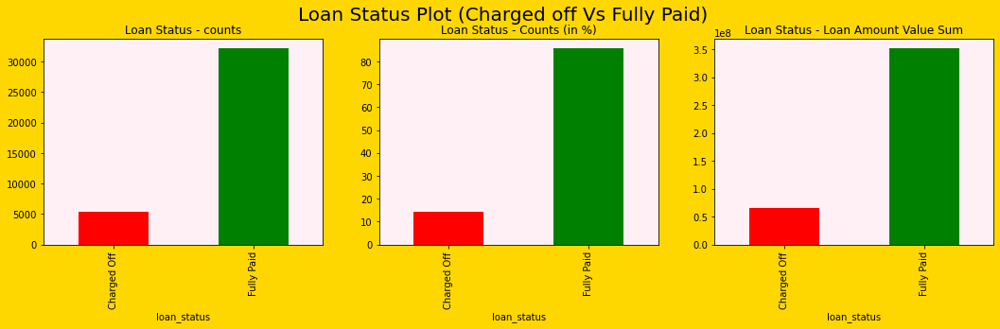

By percentage :  loan_status
Charged Off    14.0
Fully Paid     86.0
Name: loan_amnt, dtype: float64


In [44]:
fig, axs = plt.subplots(1,3, figsize=(18,4))
(ax1,ax2,ax3)=axs
fig.set_facecolor(fig_color)
ax1.set_facecolor(axis_color1)
ax2.set_facecolor(axis_color1)
ax3.set_facecolor(axis_color1)

fig.suptitle("Loan Status Plot (Charged off Vs Fully Paid)", size=20, y=1.0)


bp1=master_loan_data.groupby('loan_status').loan_amnt.count().plot(kind="bar", \
                                                                    color=col_list, \
                                                               ax=ax1, title='Loan Status - counts')


x1=master_loan_data.groupby('loan_status').loan_amnt.count()*100/len(master_loan_data)
bp2=x1.plot(kind="bar", color=col_list, ax=ax2, title='Loan Status - Counts (in %)')

x2=master_loan_data.groupby('loan_status').loan_amnt.sum()
bp3=x2.plot(kind="bar", color=col_list, ax=ax3, title='Loan Status - Loan Amount Value Sum')

plt.show()

print('By percentage : ', round(x1))

<hr>

#### Observation:

* Approximately **14%** of loans in the dataset are **defaulted**.

<hr>

__3.3 Distribution of Loan Amount disbursed__

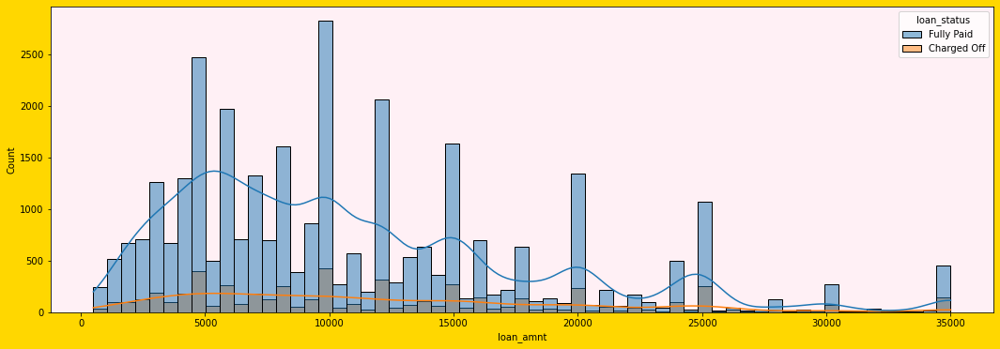

In [45]:
fig, axs = plt.subplots(figsize=(18,6))
fig.set_facecolor(fig_color)
axs.set_facecolor(axis_color1)
    
sns.histplot(data=master_loan_data, x='loan_amnt', hue='loan_status', kde=True, ax=axs)
plt.show()

<hr>

#### Observation:

* Maximum number of loan disbursed is from 5000 to 10000. There are some distribution amounting to 15k, 20k, & 25k relatively in high numbers.

* More than 25k, it is very minimal in numbers.

<hr>

__3.4 Distribution of Loan Amount disbursed over the years__

In [46]:
# Define a function to set two subplot colour & size 
def twofigplot(col1, col2, titlename):
    fig, axs = plt.subplots(1,2, figsize=(18,6))
    (ax1,ax2)=axs
    fig.set_facecolor(fig_color)
    ax1.set_facecolor(axis_color1)
    ax2.set_facecolor(axis_color1)
    fig.suptitle(titlename, size=20, y=1.0)
    return fig, ax1, ax2

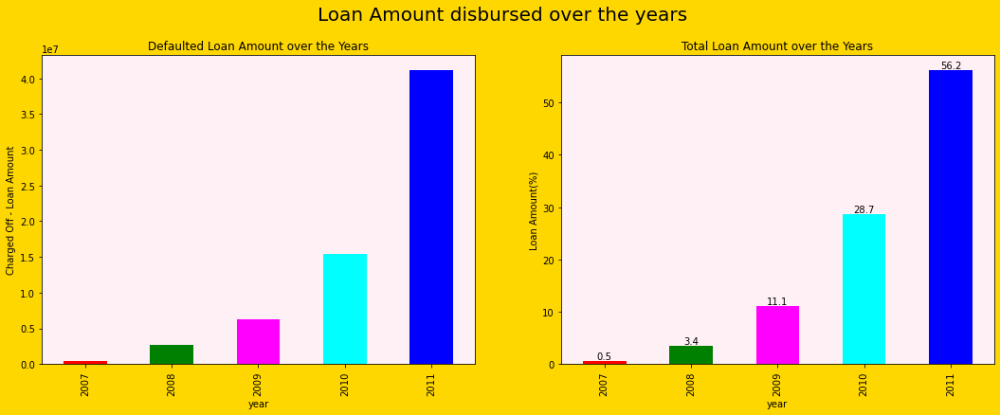

In [47]:
[fig, ax1, ax2] = twofigplot(fig_color, axis_color1, "Loan Amount disbursed over the years")

bp1=subset_master_loan_chargedOff.groupby('year').loan_amnt.sum().plot(kind="bar", \
                                                                    color=col_list, \
                                                               ax=ax1, title='Defaulted Loan Amount over the Years')
bp1.set_ylabel('Charged Off - Loan Amount')

bp2=master_loan_data.groupby('year').loan_amnt_perc.sum().plot(kind="bar", \
                                                                    color=col_list, \
                                                              ax=ax2, title='Total Loan Amount over the Years')
bp2.bar_label(bp2.containers[0],fmt='%.1f')
bp2.set_ylabel('Loan Amount(%)')

plt.show()

<hr>

#### Observation:

* Maximum number of loan disbursed in the year 2011 alone which is more than 50%.

* More the loan amount, more is the case of default

<hr>

__3.5 Categorical Plots of 'home_ownership', 'purpose', 'employment length', 'pub_rec_bankruptcies' Vs Loan Amount__

#### Home Ownership Vs Loan Amount

In [48]:
# Define a function to plot Two Figure Bar Plot agianst Loan Amount
def twofig_data_plot(df1, df2, varX, ax1, ax2, col_list, rot):
    
    bp1=(df1.groupby(varX).loan_amnt.sum()/1000).plot(kind="bar", ax=ax1, color=col_list)
    bp1.bar_label(bp1.containers[0],fmt='%d')
    bp1.set_title('Loan Amount (Charged Off + Fully Paid)')
    bp1.set_ylabel('Amount (Thousand)')
    bp1.tick_params(axis='x', rotation=rot)

    
    x= (df2.groupby(varX).loan_amnt.sum())/(df2.loan_amnt.sum())*100
    bp2=x.plot(kind="bar", ax=ax2, color=col_list)
    bp2.set_ylabel('% of Total Charged Off Sum')
    bp2.bar_label(bp2.containers[0],fmt='%.1f')
    bp2.set_title('Charged Off - Loan Amount')
    bp2.tick_params(axis='x', rotation=rot)
    
    plt.show()

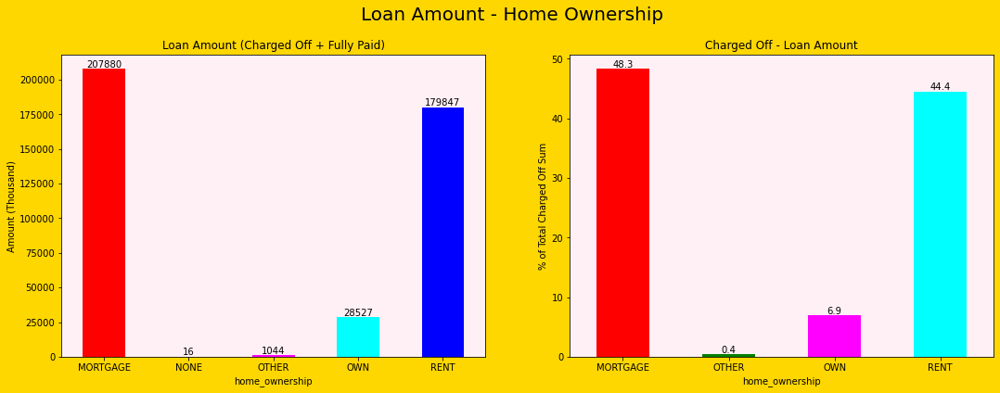

In [49]:
[fig, ax1, ax2] = twofigplot(fig_color, axis_color1, "Loan Amount - Home Ownership")

twofig_data_plot(master_loan_data, subset_master_loan_chargedOff, 'home_ownership', ax1, ax2, col_list, 0)


<hr>

#### Observation:

* Predominantly, most of the loan applicant either have mortgage something or living in a rented place, and the same category reflects for the defaulters, combining both of them are 93% of default case.


<hr>

#### Purpose Vs Loan Amount

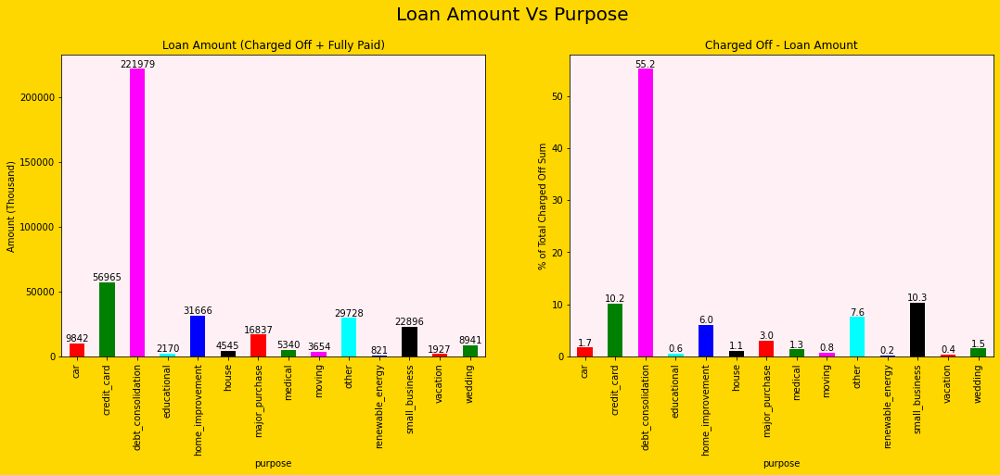

In [50]:
[fig, ax1, ax2] = twofigplot(fig_color, axis_color1, "Loan Amount Vs Purpose")

twofig_data_plot(master_loan_data, subset_master_loan_chargedOff, 'purpose', ax1, ax2, col_list, 90)


<hr>

#### Observation:

* Debt consolidation is the major factor for the loan application which is followed by credit card and home improvement.

* Defaulters are showing the same term except most of small business cases not able to repay the loan. Dafaulting from Debt consolidation category is upto 55%.

* Giving loan for debt consolidation purpose is a riskier business, more than half of them can default.



<hr>

#### Employment Length Vs Loan Amount

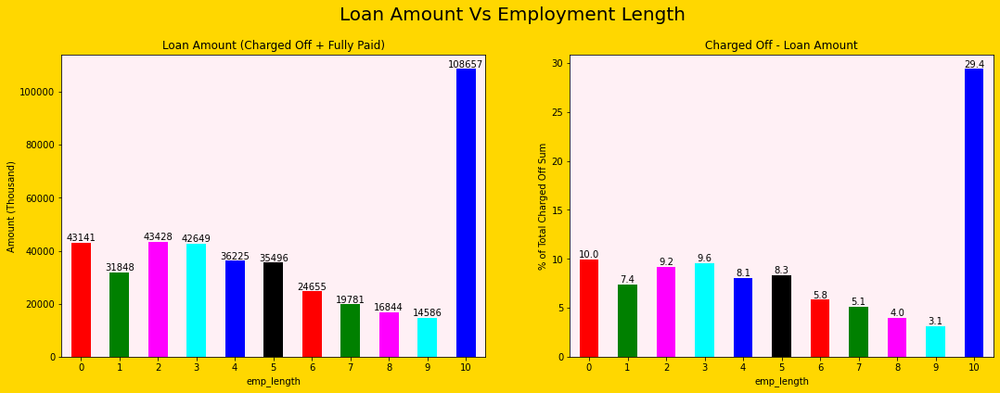

In [51]:
[fig, ax1, ax2] = twofigplot(fig_color, axis_color1, "Loan Amount Vs Employment Length")

twofig_data_plot(master_loan_data, subset_master_loan_chargedOff, 'emp_length', ax1, ax2, col_list, 0)


<hr>

#### Observation:

* Individual either in the early phase of job or 10th years onward takes the loan and by the rate they do get defaulted.

* 10+ years employees contribute for loan defaulting upto 30%, i.e., one third of total default cases.


<hr>

#### Public Bankruptcies

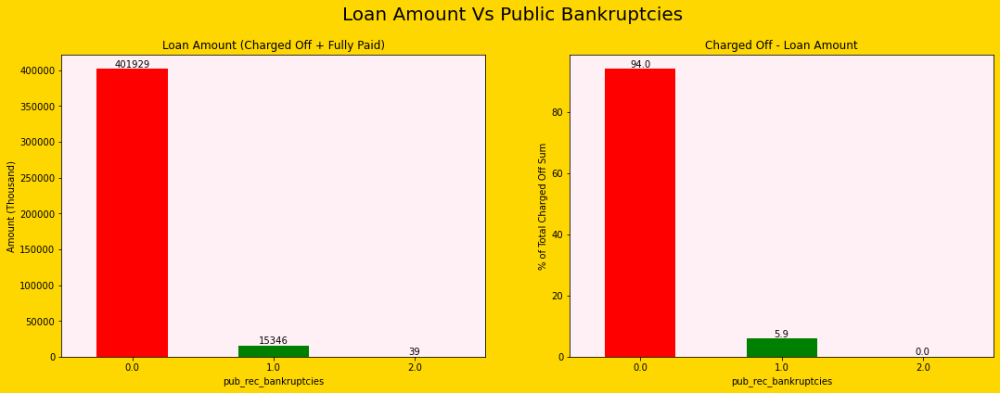

In [52]:
[fig, ax1, ax2] = twofigplot(fig_color, axis_color1, "Loan Amount Vs Public Bankruptcies")

twofig_data_plot(master_loan_data, subset_master_loan_chargedOff, 'pub_rec_bankruptcies', ax1, ax2, col_list, 0)

<hr>

#### Observation:

* 94% have no Public derogatory records. 6% have 1 derogatory public record.

* Having even 1 derogatory record increases the chances of Charge Off significantly. 


<hr>

__Verification Status Vs Loan Amount__

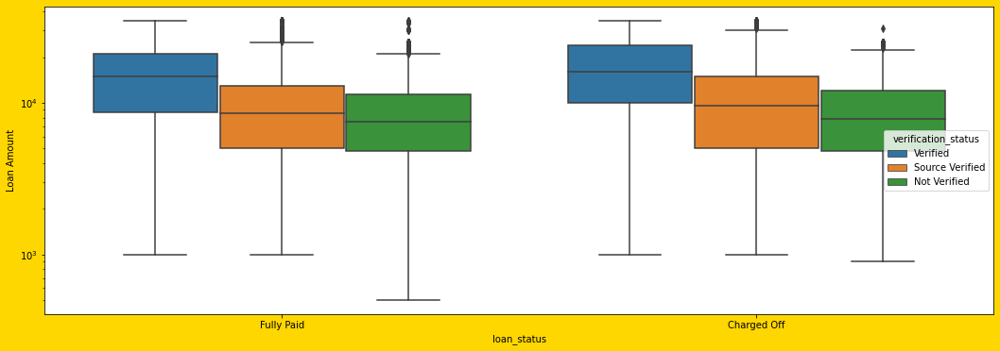

In [53]:
fig, axs = plt.subplots(figsize=(18,6))
fig.set_facecolor(fig_color)

bp1 = sns.boxplot(x='loan_status', y='loan_amnt', hue='verification_status', data=master_loan_data, ax=axs)
bp1.set_ylabel('Loan Amount')
axs.set_yscale('log')
plt.show()

<hr>

#### Observation:

* Higher Loan amounts are verified more often but it does not exclude for defaulting to pay even though it is less in total counts.


<hr>

#### DTI

A ratio calculated using the borrower’s total monthly debt payments on the total debt obligations, excluding mortgage and the requested LC loan, divided by the borrower’s self-reported monthly income.

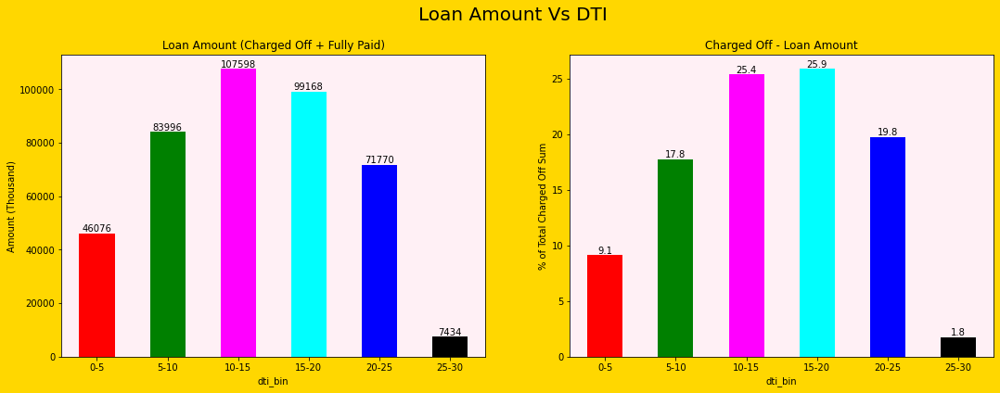

In [54]:
[fig, ax1, ax2] = twofigplot(fig_color, axis_color1, "Loan Amount Vs DTI")

twofig_data_plot(master_loan_data, subset_master_loan_chargedOff, 'dti_bin', ax1, ax2, col_list, 0)

<hr>

#### Observation:

* When the dti, dept payment to income ratio is higher than 15, higher chances of loans to get Charged Off.

* Higher the dti higher the chances of loan being Charged Off.

<hr>

### Power Law

Let's check the power law for some of the categorical valiables such as 1. grade, 2. home_ownership, 3. verification_status, 4. purpose


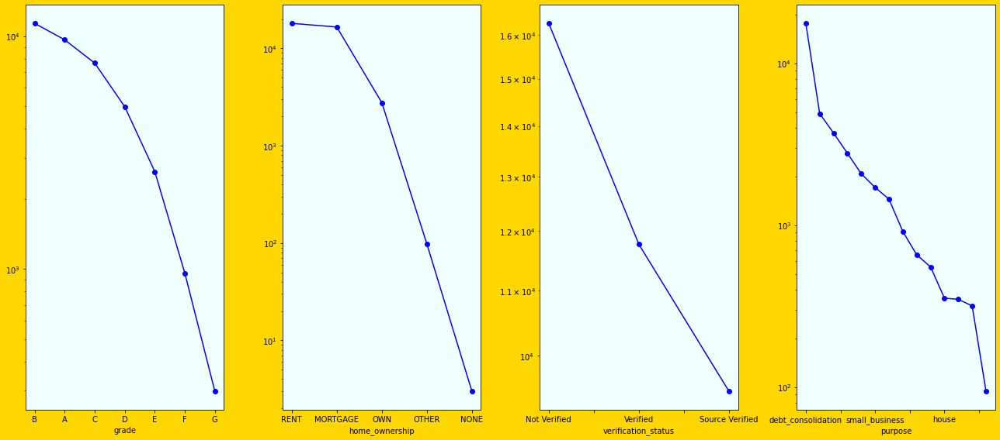

In [55]:
fig, ax_array = plt.subplots(1,4, figsize=(18,8))
(ax1, ax2, ax3, ax4) = ax_array
fig.set_facecolor(fig_color)
ax1.set_facecolor(axis_color2)
ax2.set_facecolor(axis_color2)
ax3.set_facecolor(axis_color2)
ax4.set_facecolor(axis_color2)

bp1 = master_loan_data.groupby('grade').loan_amnt.count().sort_values(ascending=False).plot(kind='line', logy=True, marker='o', color='b', ax=ax1)

bp2= master_loan_data.groupby('home_ownership').loan_amnt.count().sort_values(ascending=False).plot(kind='line', logy=True, marker='o', color='b', ax=ax2)

bp3 = master_loan_data.groupby('verification_status').loan_amnt.count().sort_values(ascending=False).plot(kind='line', logy=True, marker='o', color='b', ax=ax3)

bp4 = master_loan_data.groupby('purpose').loan_amnt.count().sort_values(ascending=False).plot(kind='line', logy=True, marker='o', color='b', ax=ax4)

plt.tight_layout()

<hr>

#### Observation:

* A relative change in the categorical quantity purpose, verification status & home ownership can proportionally change in the loan amount.

* Purpose, verification status and somewhat home ownership follows the power law distribution.

<hr>

__3.6 Box Plot of Annual Income, Loan Amount & Sanctioned Loan Amount Vs Loan Status__

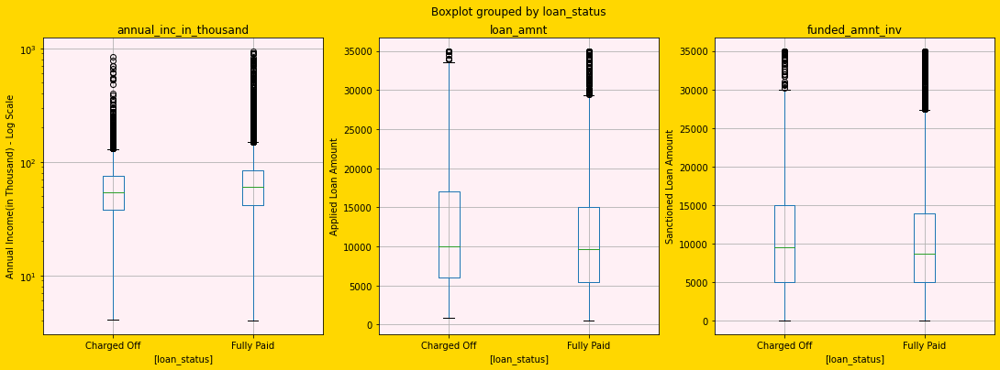

In [56]:
fig, axs = plt.subplots(1,3, figsize=(18,6))
fig.set_facecolor(fig_color)
axs[0].set_facecolor(axis_color1)
axs[1].set_facecolor(axis_color1)
axs[2].set_facecolor(axis_color1)


bp1 = master_loan_data.boxplot(column=['annual_inc_in_thousand'],\
                              by=['loan_status'],ax=axs[0], rot=0)
axs[0].set_yscale('log')
bp1.set_ylabel('Annual Income(in Thousand) - Log Scale')

bp2 = master_loan_data.boxplot(column=['loan_amnt'], by=['loan_status'],ax=axs[1], rot=0)
bp2.set_ylabel('Applied Loan Amount')

bp3 = master_loan_data.boxplot(column=['funded_amnt_inv'], by=['loan_status'],ax=axs[2], rot=0)
bp3.set_ylabel('Sanctioned Loan Amount')
plt.show()

<hr>

#### Observation:

* **Defaulted** and **Fully Paid Loan** are independent of their annual income.

* Applied loan ammount & sanctioned loan amount with respect to **defaulted** category is somewhat higher than **Fully Paid** category.

<hr>

__3.7 Interest Rate Vs Loan Amount Vs term__

Lets look at the Total Payment received with verification status

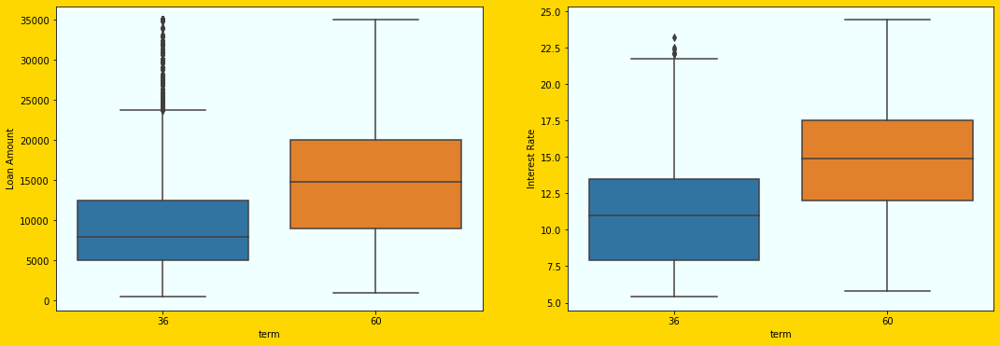

In [57]:
fig, axs = plt.subplots(1,2,figsize=(18,6))
(ax1, ax2) = axs
fig.set_facecolor(fig_color)
ax1.set_facecolor(axis_color2)
ax2.set_facecolor(axis_color2)

bp1 = sns.boxplot(x='term', y='loan_amnt', data=master_loan_data, ax=ax1)
bp1.set_ylabel('Loan Amount')

bp2 = sns.boxplot(x='term', y='int_rate', data=master_loan_data, ax=ax2)
bp2.set_ylabel('Interest Rate')

plt.show()

<hr>

#### Observation:

* Bigger the Loan amounts,  higher the term and higher the interest rate.

<hr>

__3.8 Annual Income for Different Grade__

Lets look at the annual income with different grades

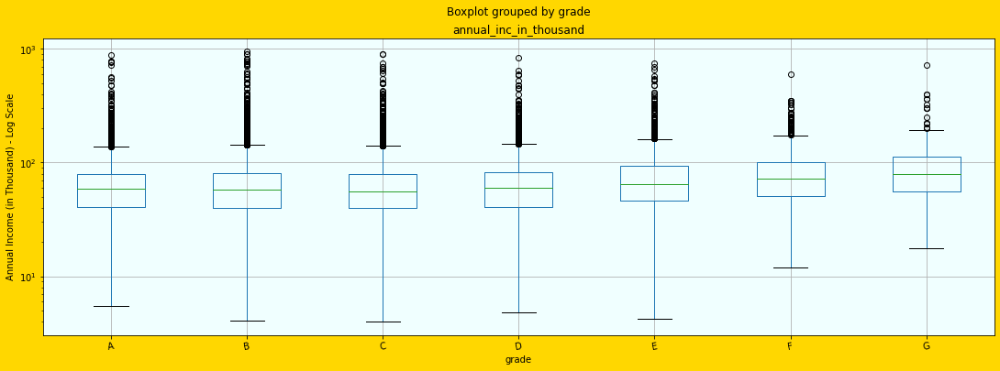

In [58]:
fig, axs = plt.subplots(figsize=(18,6))
fig.set_facecolor(fig_color)
axs.set_facecolor(axis_color2)

bp1 = master_loan_data.boxplot(column=['annual_inc_in_thousand'], by='grade', ax=axs, rot=10)

bp1.set_ylabel('Annual Income (in Thousand) - Log Scale')
axs.set_yscale('log')

plt.show()

<hr>

#### Observation:

* Grade F & G are relatively better off position for lowest most income. In gerenal, bracket from 25% to 75% percentile of  annual income of all grades are more or less same, not much big difference. 

<hr>

## Bivariate Analysis

__3.9 Box Plot of Applied Loan Amount & Sanctioned Loan Amount grouped by Grade__

Lets look at the applied loan amount & sanctioned loan amount with different grade 

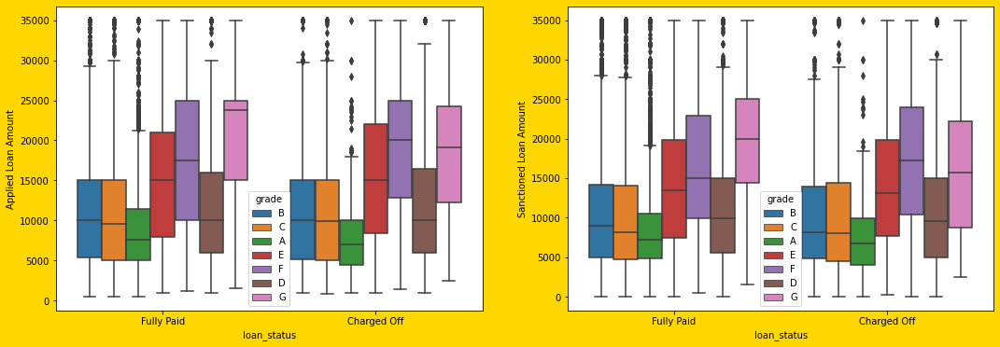

In [59]:
fig, axs = plt.subplots(1,2, figsize=(18,6))
fig.set_facecolor(fig_color)

bp1 = sns.boxplot(x='loan_status', y='loan_amnt', hue='grade', data=master_loan_data,ax=axs[0])
bp1.set_ylabel('Applied Loan Amount')

bp2 = sns.boxplot(x='loan_status', y='funded_amnt_inv', hue='grade', data=master_loan_data,ax=axs[1])
bp2.set_ylabel('Sanctioned Loan Amount')

plt.show()

<hr>

#### Observation:

* Grade E, F & G have applied for higher loan amount and they have been sanctioned the higher loan amount.

* Large proportion to default is alos being contibuted by Grade E, F & G.


<hr>

__3.10 Box Plot of Sanctioned Loan Amount, Int. Rate & Total Payment for each Grade & Sub Grade__

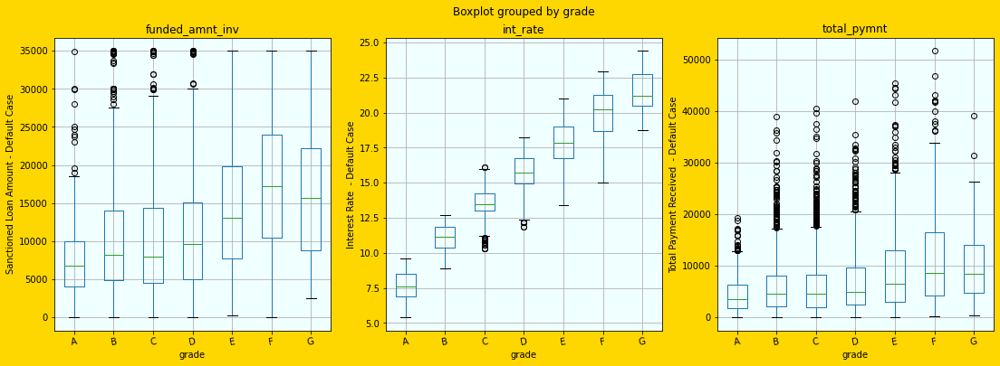

In [60]:
# Default Case
fig, ax_array = plt.subplots(1,3, figsize=(18,6))
(ax1, ax2, ax3) = ax_array
fig.set_facecolor(fig_color)
ax1.set_facecolor(axis_color2)
ax2.set_facecolor(axis_color2)
ax3.set_facecolor(axis_color2)



bp1 = subset_master_loan_chargedOff.boxplot(column=['funded_amnt_inv'], by='grade',ax=ax1, rot=10)

bp2 = subset_master_loan_chargedOff.boxplot(column=['int_rate'],\
                              by='grade',ax=ax2, rot=10)

bp3 = subset_master_loan_chargedOff.boxplot(column=['total_pymnt'],\
                              by='grade',ax=ax3, rot=10)

bp1.set_ylabel('Sanctioned Loan Amount - Default Case')
bp2.set_ylabel('Interest Rate  - Default Case')
bp3.set_ylabel('Total Payment Received  - Default Case')
plt.show()

<hr>

#### Observation:

* Sanctioned loan amount is more general relatively increasing from Grade A to Grade G.

* Interest Rate from Grade A to Grade G is significantly different to each other and increased from Grade A to Grade G. Grade A is having 6% to 9% inetrest rate whereas Grade G is paying the high interest from 18% to 24% approx.

* Even though having the higher interest Rate of 15-22% paid by the Grade F, they are less riskier among all grades even in case of default.

<hr>

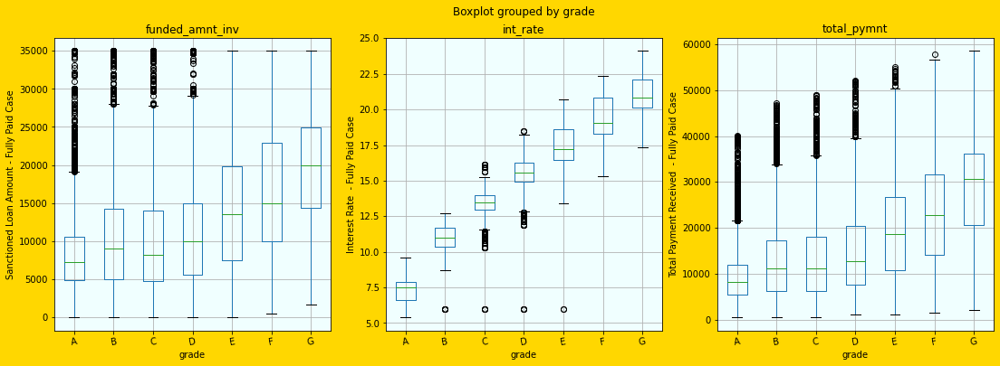

In [61]:
# Fully Paid Case
fig, ax_array = plt.subplots(1,3, figsize=(18,6))
(ax1, ax2, ax3) = ax_array
fig.set_facecolor(fig_color)
ax1.set_facecolor(axis_color2)
ax2.set_facecolor(axis_color2)
ax3.set_facecolor(axis_color2)



bp1 = subset_master_loan_FullyPaid.boxplot(column=['funded_amnt_inv'], by='grade',ax=ax1, rot=10)

bp2 = subset_master_loan_FullyPaid.boxplot(column=['int_rate'],\
                              by='grade',ax=ax2, rot=10)

bp3 = subset_master_loan_FullyPaid.boxplot(column=['total_pymnt'],\
                              by='grade',ax=ax3, rot=10)

bp1.set_ylabel('Sanctioned Loan Amount - Fully Paid Case')
bp2.set_ylabel('Interest Rate  - Fully Paid Case')
bp3.set_ylabel('Total Payment Received  - Fully Paid Case')
plt.show()

<hr>

#### Observation:

* Grade E, F & G have given the most profits to the lending company.

<hr>

#### 3.11 Interest Rate for each Sub Grade (Univariate Analysis)

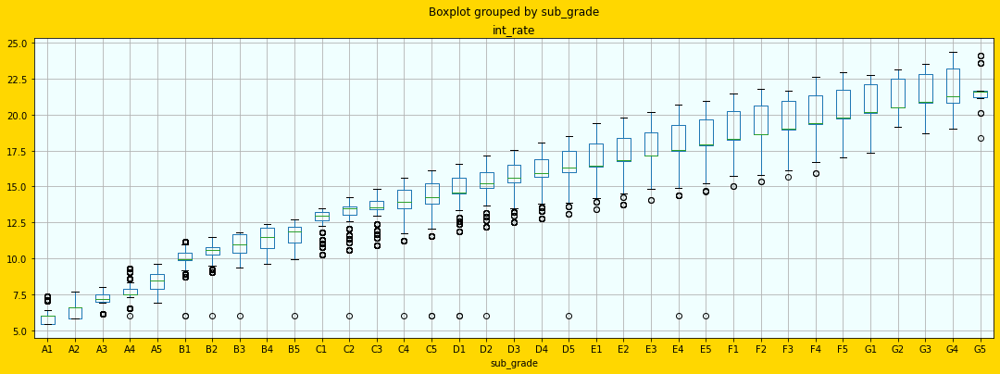

In [62]:
fig, axs = plt.subplots(figsize=(18,6))
fig.set_facecolor(fig_color)
axs.set_facecolor(axis_color2)

bp = master_loan_data.boxplot(column=['int_rate'], by='sub_grade',ax=axs)
plt.show()

<hr>

#### Observation:

* Intrest rates are directly proportional to the subgrade. Larger or lower the sub grade, higher or lower are the rate of intrest for the loan.

<hr>

__3.12 Loan amount Vs addr_state grouped by loan Status__

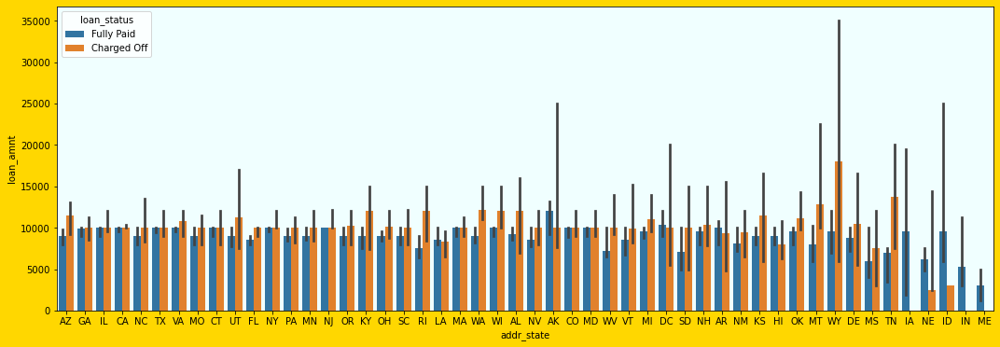

In [63]:
fig, axs = plt.subplots(figsize=(18,6))
fig.set_facecolor(fig_color)
axs.set_facecolor(axis_color2)

bp1=sns.barplot(x='addr_state', y='loan_amnt', hue='loan_status',data=master_loan_data, estimator = np.median)
plt.show()


<hr>

#### Observation:

* Interesting to observe, States WY has the highest average(median) loan amount that was charged off. State must be looked into by the LC for further investigation.

<hr>

#### 3.13 Estimate the correlation matrix to produce the heat map of various valiables

In [64]:
corr_matrix=master_loan_data.corr()
corr_matrix['loan_amnt']

id                         0.125168
member_id                  0.125243
loan_amnt                  1.000000
funded_amnt                0.981618
funded_amnt_inv            0.936898
term                       0.345518
int_rate                   0.299192
installment                0.931724
emp_length                 0.149022
annual_inc_in_thousand     0.363370
dti                        0.061340
delinq_2yrs               -0.033733
inq_last_6mths             0.012981
open_acc                   0.174079
pub_rec                   -0.046393
revol_bal                  0.313606
total_acc                  0.255653
total_pymnt                0.881410
total_pymnt_inv            0.846599
total_rec_prncp            0.845326
total_rec_int              0.727350
total_rec_late_fee         0.046946
recoveries                 0.142272
collection_recovery_fee    0.076343
last_pymnt_amnt            0.473587
pub_rec_bankruptcies      -0.030912
year                       0.115026
month                      0

Let's have a entire correlation glance through the Heat Map

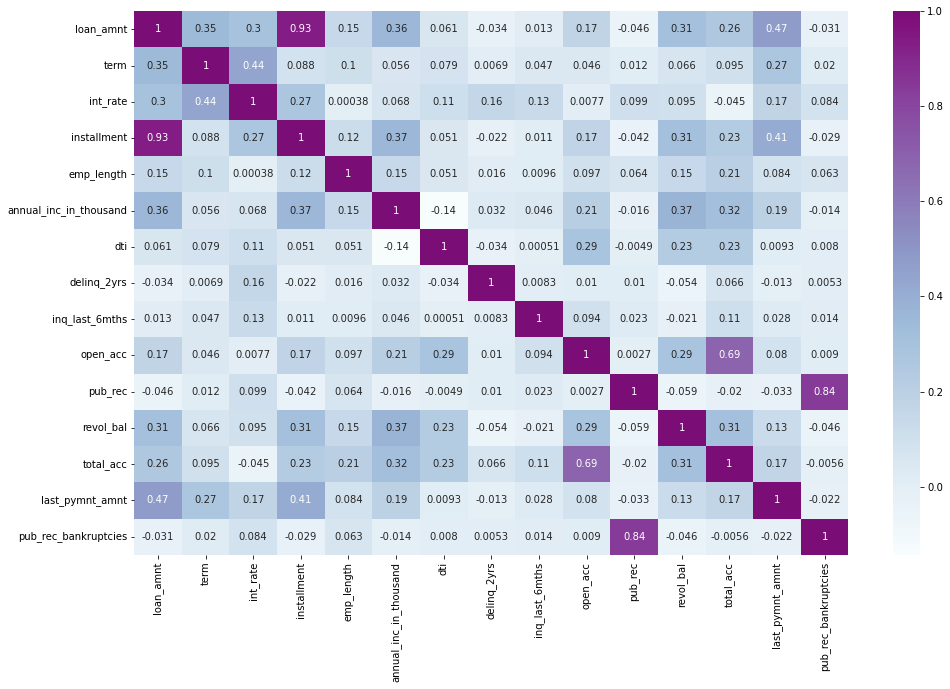

In [65]:
plt.figure(figsize=(16,10))

cont_var= ['loan_amnt','term','int_rate', 'installment', 'emp_length', 'annual_inc_in_thousand',\
           'dti', 'delinq_2yrs', 'inq_last_6mths', 'open_acc', 'pub_rec', 'revol_bal', \
           'total_acc', 'last_pymnt_amnt', 'pub_rec_bankruptcies']
corr = master_loan_data[cont_var].corr()
sns.heatmap(corr, annot=True, center=0.5, cmap="BuPu")
plt.show()

<hr>

#### Observation:

* Loan amount is highly correlated positively with number of instalment & last payment by 93% and 47% respectively.

* Loan amount is correlated positively with the revolving balance amount by 31%, this means riskier loans are getting approved.

* Revolving balance correlated positively with Annual income & Instalment by 37 % to 31%.

* Employment length not greatly correlatable to loan amount, instalment or interest rate.

* Public Bankruptcies is negatively correlated with loan amount; avoid giving loan to the public derogatory holder.

* Low value correlation suggest that of many variables suggest, they are not correlatable and hence will produce no trend to each other.


<hr>

### Conclusions:

* Approximately **14%** of loans in the provided dataset are **defaulted**.

* Maximum number of loan disbursed is from 5000 to 10000. Maximum number of loan disbursed in the year 2011 alone which is more than 50%.

* Predominantly, most of the loan applicant either have **mortgage** something or living in a **rented** place, and the same category reflects for the defaulters, combining both of them are **93% of default case**.

* Giving loan for **debt consolidation purpose** is a **riskier business**, more than half of them (out of total default case) can default.

* **10+ years employees** contribute for loan defaulting upto **30%**, i.e., one third of total default cases.

* **Avoid giving loan** to the applicant who has even **one public derogatory record**.
	
* When **dti**, dept payment to income ratio is **higher than 15**, they are **likely to default**.

* Other than very income group, annual income does not affect the loan defaulting.

* **Grade employee (E, F & G)** have given the **most profits** to the lending company with **high interest rate** suitably with **15-22%** rate.

* **States WY** has the highest average(median) loan amount that was **charged off**. This state must be looked into by the LC for further investigation.
